<a href="https://colab.research.google.com/github/Matheus-lucas/Filtros-Digitais/blob/main/Projeto_de_Filtros.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Bibliotecas

In [ ]:
from math import log10, pi, sin, cos, ceil
from scipy import signal
import matplotlib.pyplot as plt
import numpy as np

## Definindo a Função do Filtro Passa-Baixas

In [ ]:
def low_pass(Ap = -1,As = -40, Wp = 1000, Ws = 5000 ):
  """Definição de Variáveis
  Ap = -1 # dB
  As = -40 # dB
  Wp = 1000 # rad/s
  Ws = 5000 # rad/s
  Rl = 50 # Ohms
  Rs = Rl # Ohms // Rl = Rs -> Consideração minha
  """

  # Definição da Ordem do Filtro
  n = log10( (pow(10, (-Ap/10)) - 1) / (pow(10,(-As/10)) - 1) ) /\
                                         (2*log10(Wp/Ws))
  N = ceil(n)

  # Definição da Frequência de Corte
  Wc = Wp / pow((pow(10, (-Ap/10))-1), (1/(2*N)))

  # Definição dos polos unitários
  Sk = list()
  for k in range(1, N+1):
      Sk.append( complex(-sin( (pi*(2*k-1)) / (2*N) ), 
                         cos( (pi*(2*k-1))/ (2*N) )))
      
  # Extrai as raízes da função
  raizes = list()
  raizes = np.poly(Sk)
      
  # Transforma Sk em vetor de coeficientes reais
  coefMod = raizes.real

  # Definição dos Coeficientes do Denominador
  aux = 0
  coef = list()
  for i in range(-N, 1):
      coef.append(coefMod[aux]*pow(Wc, i))
      aux = aux + 1

  # Função de Transferência 
  H = signal.TransferFunction(coef[-1], coef)

  # Plotagem do Módulo
  w, y, phase = signal.bode(H)
  plt.figure(1)
  plt.grid(True)
  plt.plot(w, y)
  plt.legend(["Magnitude"])
  plt.show()

  # Plotagem da Fase
  w, y, phase = signal.bode(H)
  plt.figure(2)
  plt.grid(True)
  plt.plot(w, phase, 'r')
  plt.legend(["Phase"])
  plt.show()

  return H

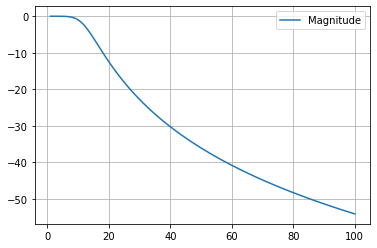

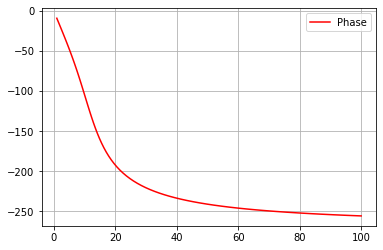

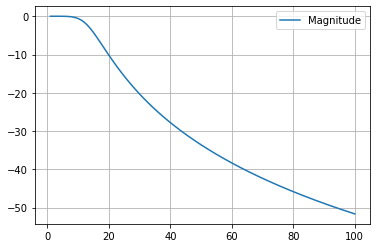

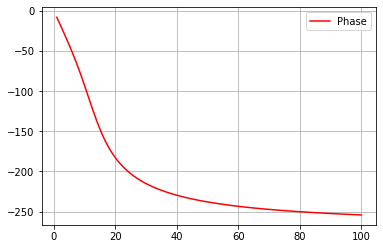

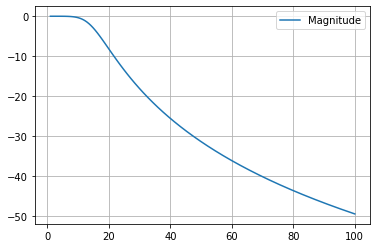

...

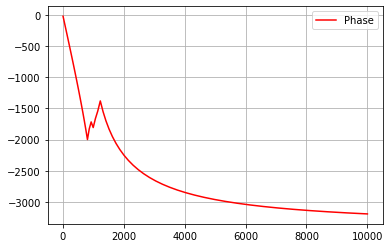

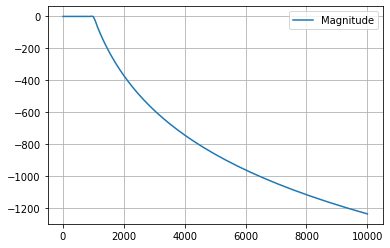

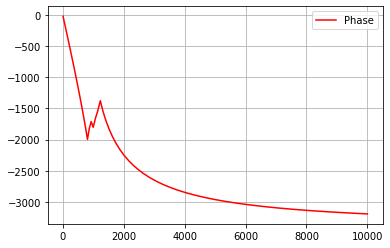

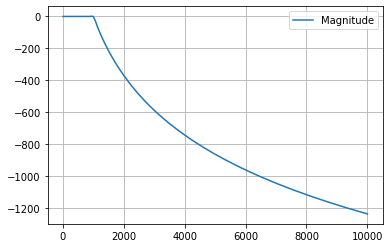

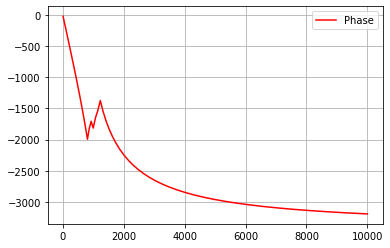

In [ ]:
Aps=-1
Ass=-40
Wcs=range(10, 1000)
Wss=range(100, 1100)
for i in range(len(Wcs)):
      low_pass1 = low_pass(Wp=Wcs[i],Ws=Wss[i])

In [ ]:
  print("Transference Function: ")
  i=0
  str_dem = list()
  for x in low_pass1.den:
        str_dem.append(str(x)+"*s^{}".format(i))
        i+=1
  print(low_pass1.num)
  print("-------------------------------")
  print(str_dem)
  